[研究テーマ再検討メモ](https://www.evernote.com/shard/s18/nl/2015215/7ee92d3e-18be-4253-f0ea-38e22e791af1?title=%E7%A0%94%E7%A9%B6%E3%83%86%E3%83%BC%E3%83%9E%E3%81%AE%E5%86%8D%E6%A4%9C%E8%A8%8E)

人口が減った時に、協力が進化すると同時にスケールフリーネットワークが形成されるモデルを考える。

---

環境変動によって人口が減った時に協力が進化し、人口が増えると非協力が進化する。→ 自明

人口が減った時に形成される社会関係資本が、人口が増えたときの非協力の進化を抑制する。→ これが言えれば研究として成り立つ。

---

協力に有利な環境で協力が進化し、協力に不利な環境で非協力が進化する。→ 自明

協力に有利な時に形成された社会関係資本が、協力に不利な時の非協力の進化を抑制する。→ これが言えれば研究として成り立つ。

---

このノートは失敗。基本的に何の洞察も得られなかった。

コンフォーミストバイアスを導入してみたが、スケールフリーネットワークが形成され、人口に関わらず協力が進化しやすくなっただけ。

In [1]:
using Plots: plot, plot!, Plot
using StatsBase: mean

include("../src/Simulation.jl")
include("../src/EnvironmentalVariation.jl")

using Main.Simulation
using Main.EnvironmentalVariation

Threads.nthreads()

12

In [2]:
function plot_time_series(
    N_vec::Vector{Int},
    cooperation_rate_matrix::Matrix{Float64},
    mean_degree_matrix::Matrix{Float64},
    std_degree_matrix::Matrix{Float64},
    local_cooperation_rate_matrix::Matrix{Float64}
)::Plot
    t_max, trial_max = size(cooperation_rate_matrix)

    # Population
    p_N = plot(N_vec, xlim = (0, t_max), xticks = 0:500:t_max, legend = false, title = "Population")
    
    # Cooperation rate
    p_cooperation_rate_matrix = plot(xlim = (0, t_max), xticks = 0:500:t_max, ylim = (0, 1), yticks = 0:0.1:1, legend = false, title = "Cooperation Rate")
    
    for trial in 1:trial_max
        plot!(cooperation_rate_matrix[:, trial])
    end
    
    plot!(mean(cooperation_rate_matrix, dims=2), lc = :black, lw = 3)

    # Local cooperation rate
    p_local_cooperation_rate = plot(xlim = (0, t_max), xticks = 0:500:t_max, ylim = (0, 1), yticks = 0:0.1:1, legend = false, title = "Local Cooperation Rate")
    
    for trial in 1:trial_max
        plot!(local_cooperation_rate_matrix[:, trial])
    end
    
    plot!(mean(local_cooperation_rate_matrix, dims=2), lc = :black, lw = 3)
    
    # Degree
    p_degree_matrix = plot(xlim = (0, t_max), xticks = 0:500:t_max, legend = false, title = "Degree")
    
    for trial in 1:trial_max
        plot!(mean_degree_matrix[:, trial])
    end
    
    plot!(mean(mean_degree_matrix, dims=2), lc = :black, lw = 3)
    
    return plot(p_N, p_cooperation_rate_matrix, p_local_cooperation_rate, p_degree_matrix, layout = (4, 1), size = (1000, 1000))
end;

In [3]:
μ = 100
σ = 50
β = 0.7
τ = 10
t_max = 5_000
N_vec_flat = fill(μ, t_max + 1)
N_vec_ar1 = ar1(μ, σ, β, τ, t_max + 1) |> v -> prune(v, μ * 10, μ ÷ 10) |> v -> smoothen(v, 1.1)
N_vec_two_level1 = two_level_var(100, 1000, 500, 1000, t_max + 1) |> v -> smoothen(v, 1.1);
N_vec_two_level2 = two_level_var(100, 100, 500, 100, t_max + 1) |> v -> smoothen(v, 1.1);

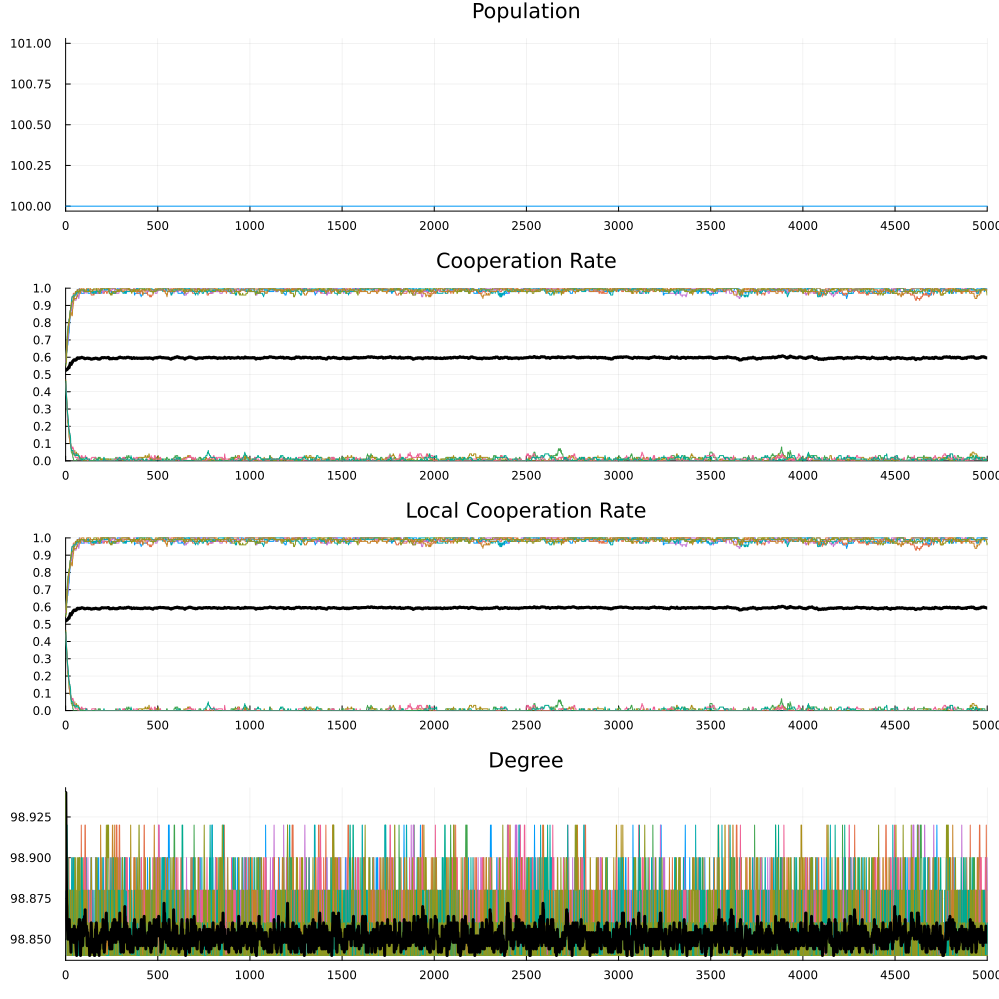

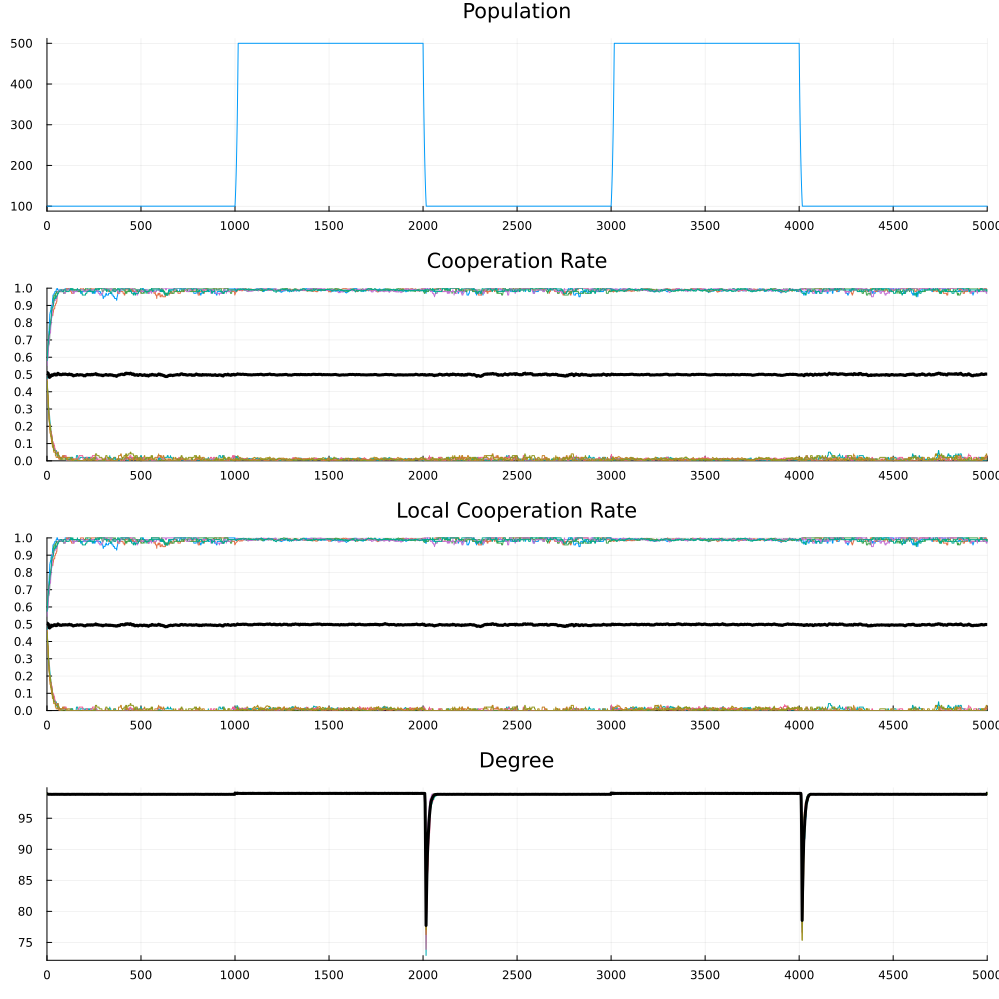

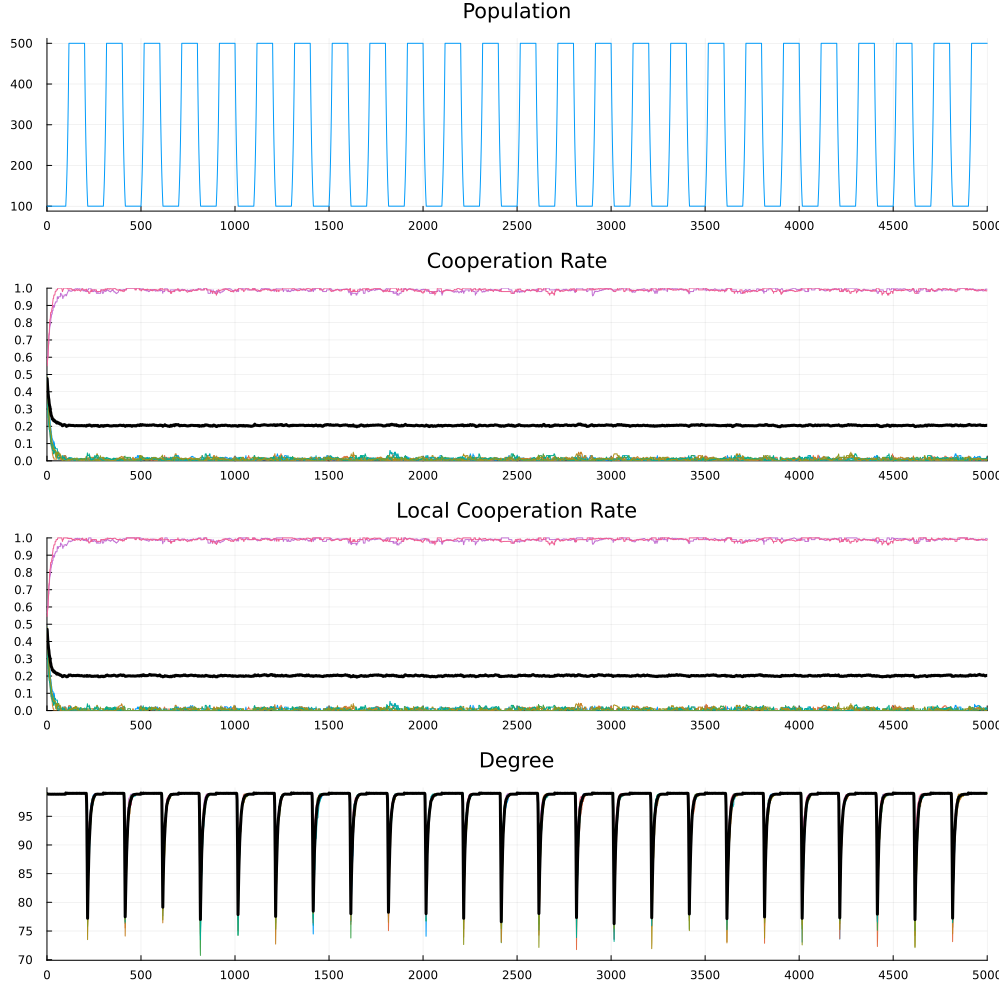

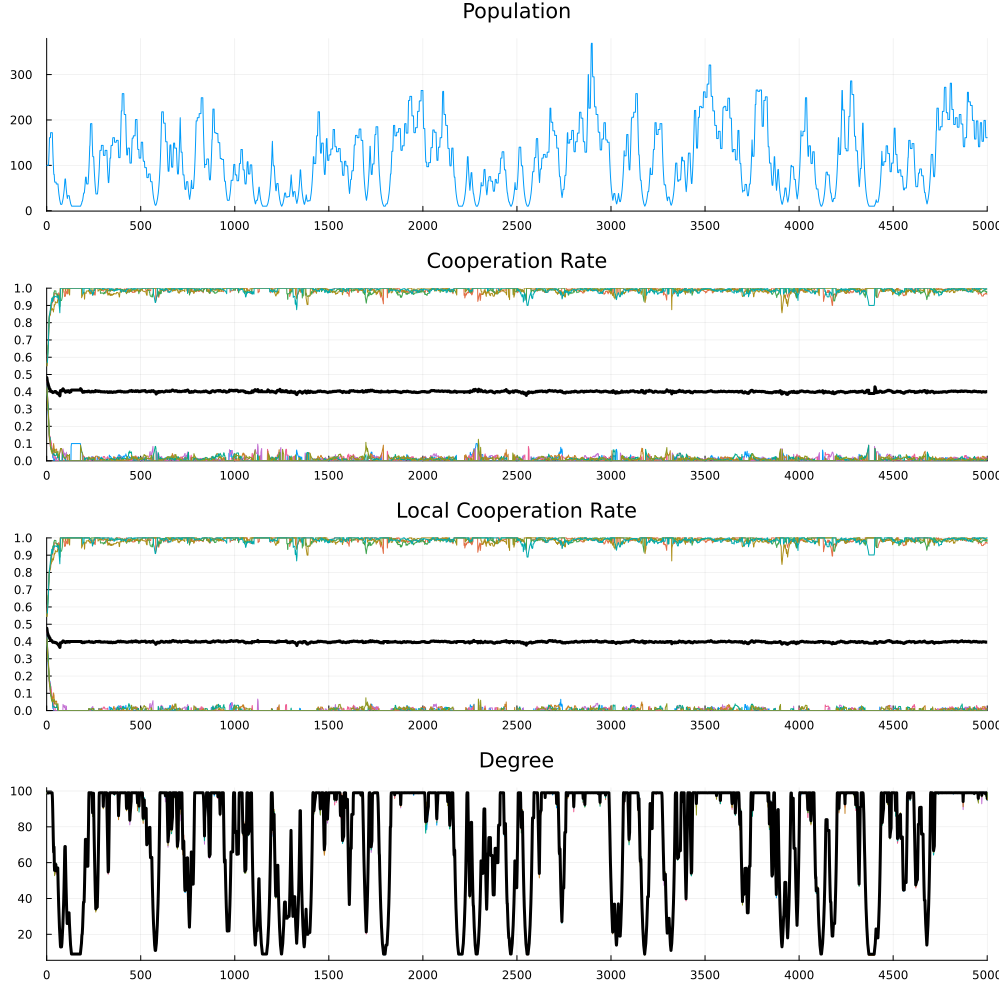

In [4]:
T = 1.15
S = -0.15
k = 99

for N_vec in [N_vec_flat, N_vec_two_level1, N_vec_two_level2, N_vec_ar1]
    param = Param(k₁ = k, t_max = t_max)
    cooperation_rate_matrix, mean_degree_matrix, std_degree_matrix, local_cooperation_rate_matrix = Simulation.run(param, N_vec, T, S)
    plot_time_series(N_vec, cooperation_rate_matrix, mean_degree_matrix, std_degree_matrix, local_cooperation_rate_matrix) |> display
end

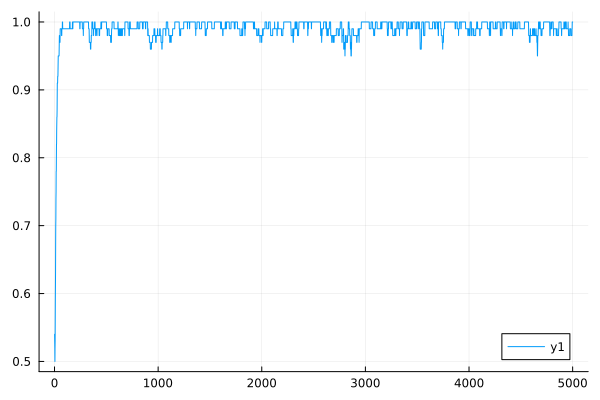

In [5]:
T = 1.1
S = -0.1
k = 10

payoff_table = Dict(
    (C, C) => (1.0, 1.0),
    (C, D) => (S, T),
    (D, C) => (T, S),
    (D, D) => (0.0, 0.0)
)

function run(param::Param, N_vec::Vector{Int})::Tuple{Vector, Vector, Model}
    @assert param.t_max + 1 == length(N_vec)
    
    payoff_table_vec = fill(payoff_table, param.t_max)
    model = Model(param, N_vec, payoff_table_vec)

    cooperation_rate_vec = fill(0.0, param.t_max)
    weights_vec = []

    for t = 1:(model.param.t_max)
        run_one_step!(model, t)

        cooperation_rate_vec[t] = cooperation_rate(model)
        append!(weights_vec, model.weights)
    end

    return cooperation_rate_vec, weights_vec, model
end

param = Param(k₁ = k, t_max = t_max)
cooperation_rate_vec, weights_vec, model = run(param, N_vec_flat)
plot(cooperation_rate_vec)

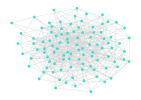

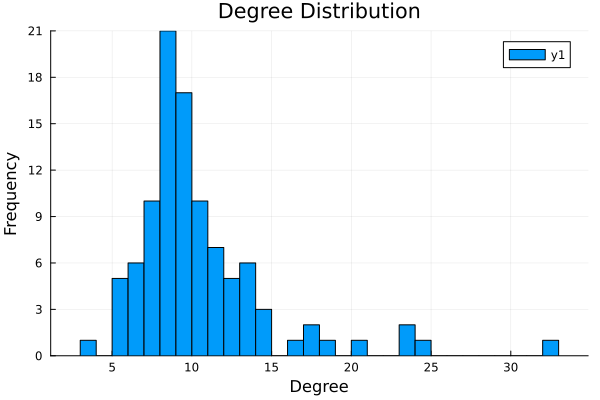

In [6]:
using Graphs
using GraphPlot
using Plots: histogram

g = SimpleGraph(model.weights .> 0)
gplot(g) |> display
degrees = degree(g)
histogram(degrees, bins=maximum(degrees)-minimum(degrees)+1, xlabel="Degree", ylabel="Frequency", title="Degree Distribution")

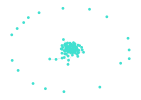

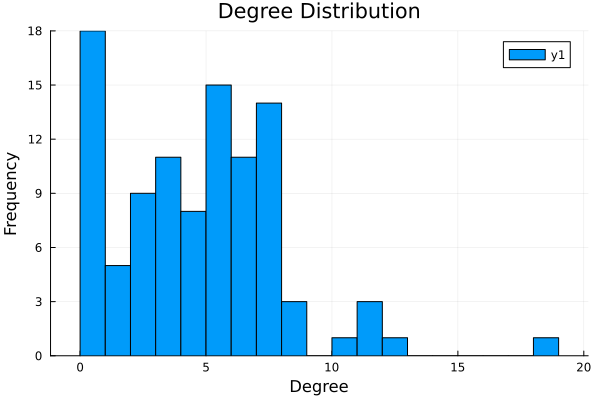

In [7]:
g = SimpleGraph(model.weights .> 0.7)
gplot(g) |> display
degrees = degree(g)
histogram(degrees, bins=maximum(degrees)-minimum(degrees)+1, xlabel="Degree", ylabel="Frequency", title="Degree Distribution")